In [1]:
import sys
sys.path.append("../")

In [3]:
from data_utils import load_svhn

source_train_loader, source_test_loader = load_svhn(img_size=(32, 32), batch_size=128, split=1, shuffle=True, num_workers=8)

Using downloaded and verified file: ../data/train_32x32.mat


In [4]:
import torch.optim as optim 
from torch import nn
from models import DisentangledNetwork, Decoder, DisentanglementEncoder

encoder = DisentanglementEncoder(latent_space_dim=150, nb_channels=3)
encoder.embedder = nn.Sequential(
                    nn.Conv2d(3, out_channels=32, kernel_size=5, padding=2),
                    nn.ReLU(True),
                    nn.MaxPool2d(kernel_size=2, stride=2),
                    nn.Conv2d(in_channels=32, out_channels=64, kernel_size=5, padding=2),
                    nn.ReLU(True),
                    nn.MaxPool2d(kernel_size=2, stride=2),
                    nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
                    nn.ReLU(True),
                    nn.Flatten(),
                    nn.Linear(in_features=8192, out_features=1024),
                    nn.ReLU(True),
                )
conv_feat_size = [128, 8, 8]
decoder = Decoder(latent_space_dim=300, conv_feat_size=conv_feat_size, nb_channels=3)
model = DisentangledNetwork(encoder, decoder).cuda()
optimizer = optim.Adam(model.parameters(), lr=5e-4, weight_decay=0.001)

Matplotlib created a temporary config/cache directory at /tmp/matplotlib-3amjkgrv because the default path (/home/david.bertoin/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
  0%|                                                                                                                               | 0/50 [00:00<?, ?it/s]/home/david.bertoin/.conda/envs/torch/lib/python3.8/site-packages/torch/nn/functional.py:756: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /opt/conda/conda-bld/pytorch_1623448278899/work/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
epoch:0 curre

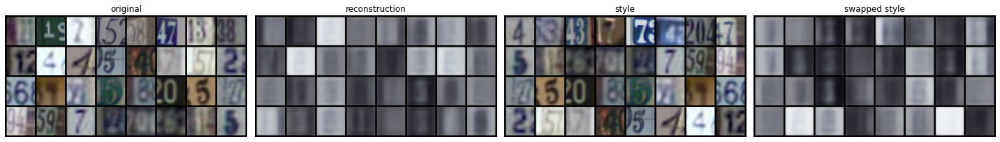

epoch:1 current accuracy:47.08%:   2%|█▋                                                                                    | 1/50 [00:31<13:15, 16.23s/it]

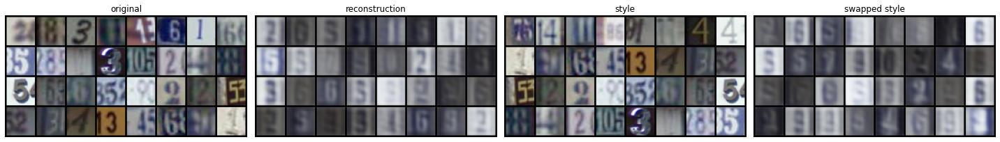

epoch:2 current accuracy:78.23%:   4%|███▍                                                                                  | 2/50 [00:47<12:52, 16.09s/it]

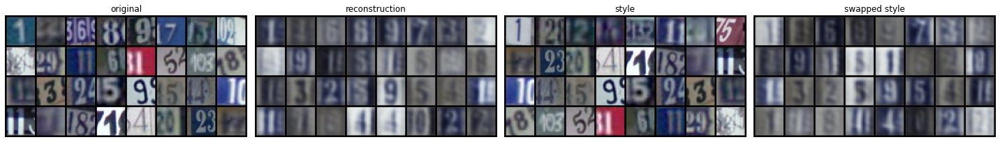

epoch:3 current accuracy:85.84%:   6%|█████▏                                                                                | 3/50 [01:03<12:33, 16.03s/it]

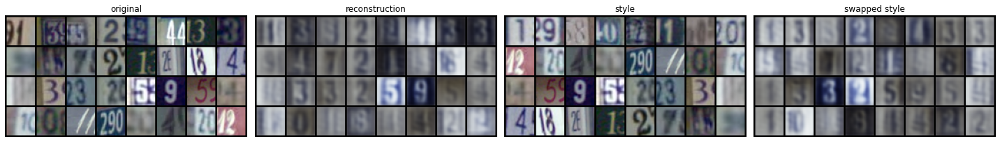

epoch:4 current accuracy:88.48%:   8%|██████▉                                                                               | 4/50 [01:19<12:17, 16.03s/it]

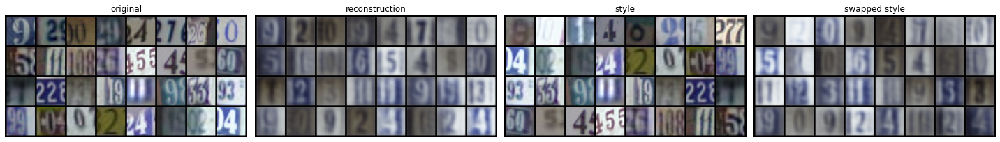

epoch:5 current accuracy:89.98%:  10%|████████▌                                                                             | 5/50 [01:35<12:00, 16.01s/it]

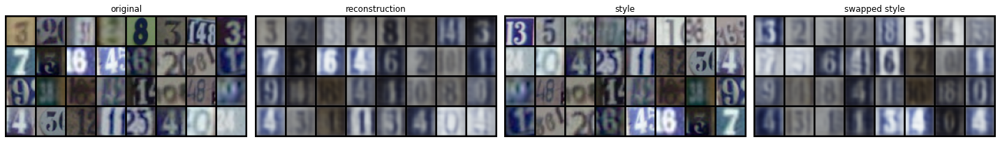

epoch:6 current accuracy:91.15%:  12%|██████████▎                                                                           | 6/50 [01:51<11:43, 15.98s/it]

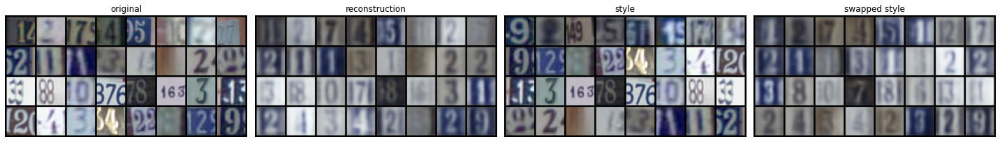

epoch:7 current accuracy:92.03%:  14%|████████████                                                                          | 7/50 [02:07<11:30, 16.06s/it]

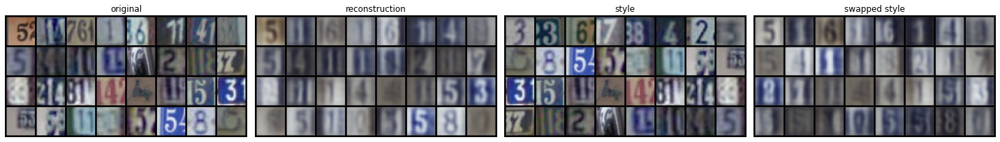

epoch:8 current accuracy:92.59%:  16%|█████████████▊                                                                        | 8/50 [02:24<11:13, 16.04s/it]

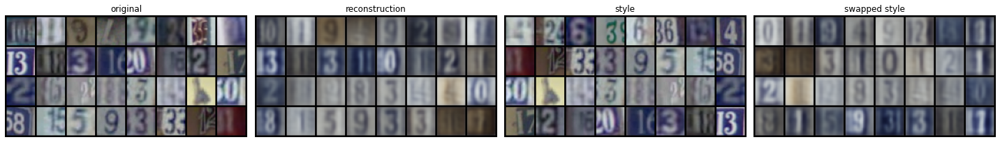

epoch:9 current accuracy:93.39%:  18%|███████████████▍                                                                      | 9/50 [02:39<10:57, 16.03s/it]

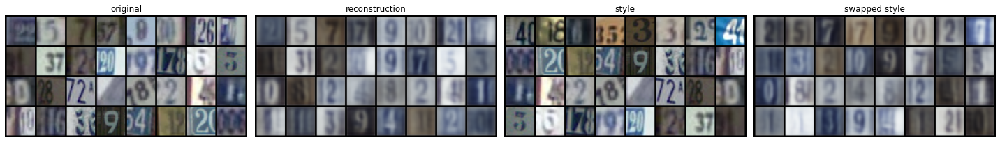

epoch:10 current accuracy:93.83%:  20%|████████████████▊                                                                   | 10/50 [02:55<10:40, 16.01s/it]

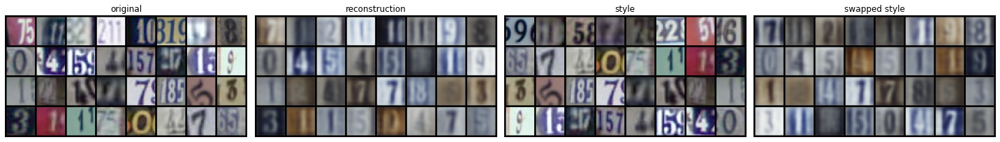

epoch:11 current accuracy:94.32%:  22%|██████████████████▍                                                                 | 11/50 [03:11<10:24, 16.00s/it]

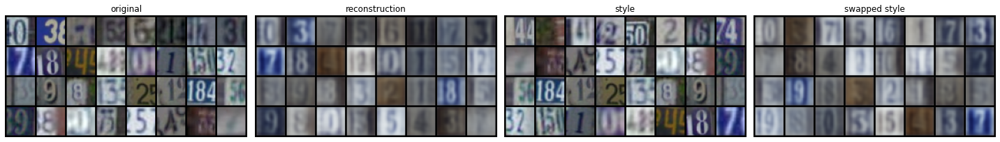

epoch:12 current accuracy:94.67%:  24%|████████████████████▏                                                               | 12/50 [03:28<10:09, 16.03s/it]

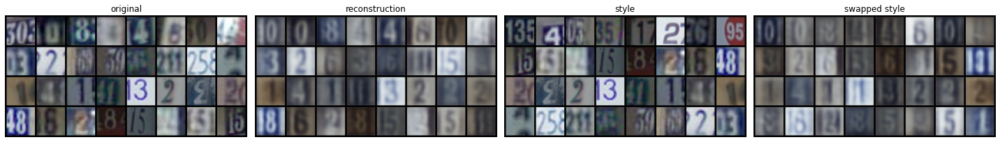

epoch:13 current accuracy:94.98%:  26%|█████████████████████▊                                                              | 13/50 [03:44<09:53, 16.03s/it]

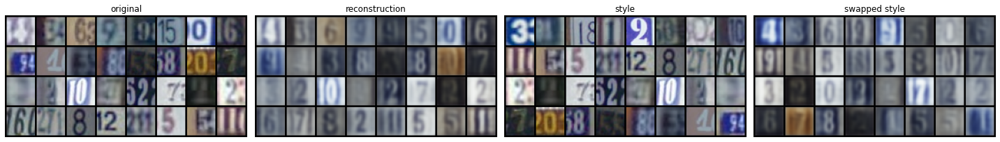

epoch:14 current accuracy:95.4%:  28%|███████████████████████▊                                                             | 14/50 [04:00<09:37, 16.04s/it]

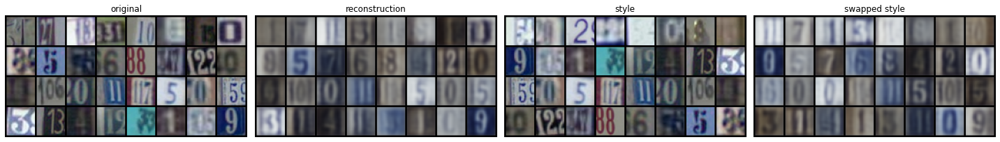

epoch:15 current accuracy:95.6%:  30%|█████████████████████████▌                                                           | 15/50 [04:16<09:21, 16.04s/it]

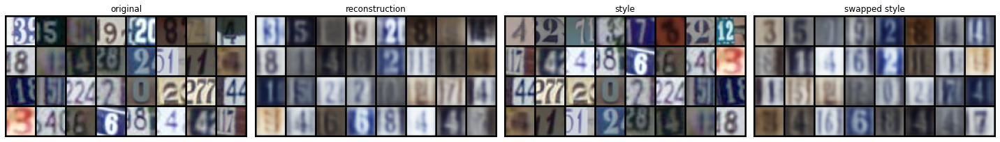

epoch:16 current accuracy:95.87%:  32%|██████████████████████████▉                                                         | 16/50 [04:32<09:05, 16.03s/it]

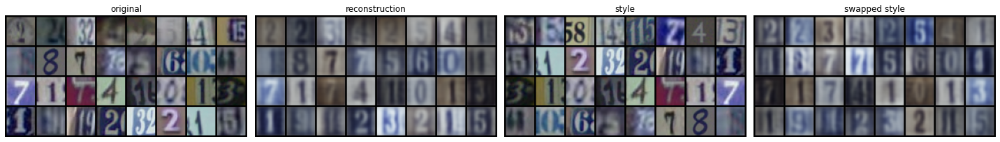

epoch:17 current accuracy:95.99%:  34%|████████████████████████████▌                                                       | 17/50 [04:48<08:49, 16.04s/it]

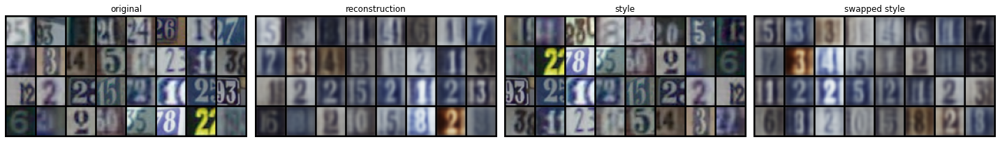

epoch:18 current accuracy:96.19%:  36%|██████████████████████████████▏                                                     | 18/50 [05:04<08:34, 16.09s/it]

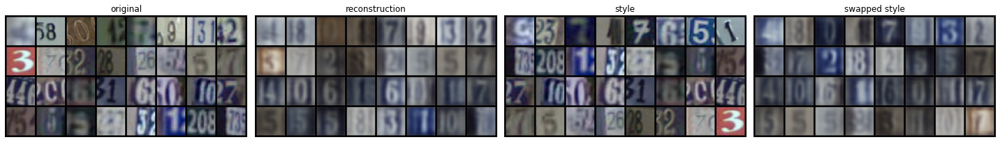

epoch:19 current accuracy:96.48%:  38%|███████████████████████████████▉                                                    | 19/50 [05:20<08:18, 16.08s/it]

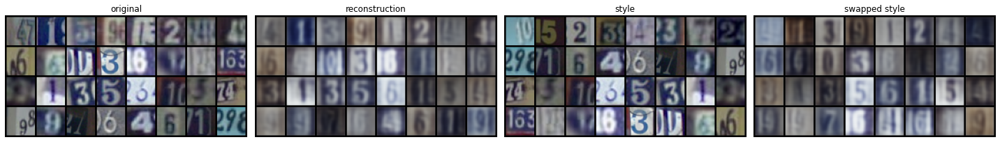

epoch:20 current accuracy:96.48%:  40%|█████████████████████████████████▌                                                  | 20/50 [05:36<08:01, 16.06s/it]

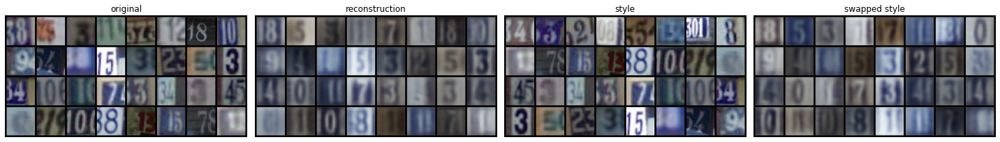

epoch:21 current accuracy:96.56%:  42%|███████████████████████████████████▎                                                | 21/50 [05:52<07:45, 16.04s/it]

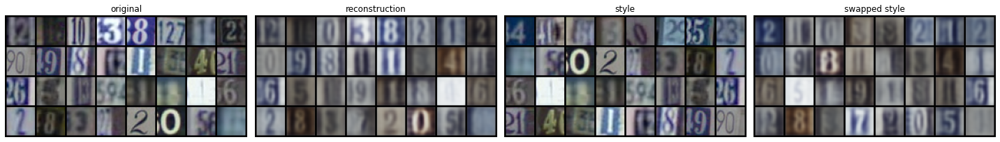

epoch:22 current accuracy:96.83%:  44%|████████████████████████████████████▉                                               | 22/50 [06:08<07:29, 16.05s/it]

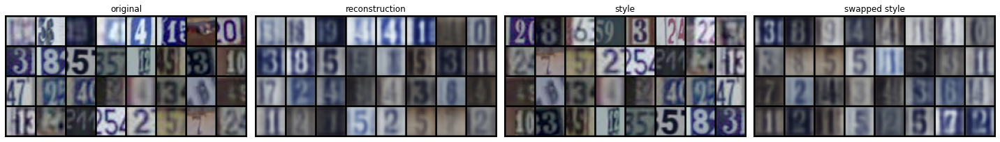

epoch:23 current accuracy:96.97%:  46%|██████████████████████████████████████▋                                             | 23/50 [06:24<07:13, 16.05s/it]

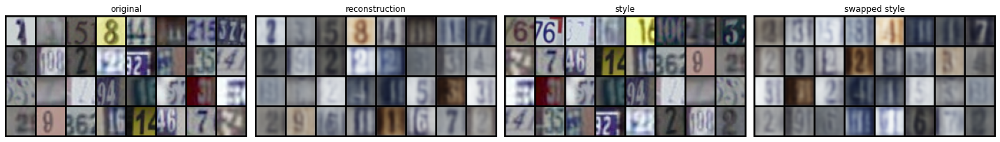

epoch:24 current accuracy:97.02%:  48%|████████████████████████████████████████▎                                           | 24/50 [06:40<06:57, 16.05s/it]

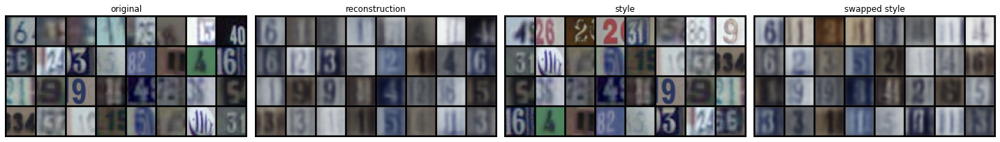

epoch:25 current accuracy:97.15%:  50%|██████████████████████████████████████████                                          | 25/50 [06:56<06:41, 16.04s/it]

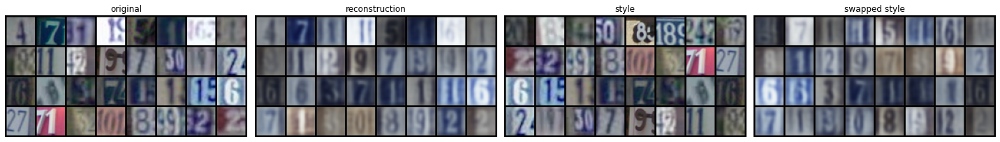

epoch:26 current accuracy:97.2%:  52%|████████████████████████████████████████████▏                                        | 26/50 [07:12<06:25, 16.04s/it]

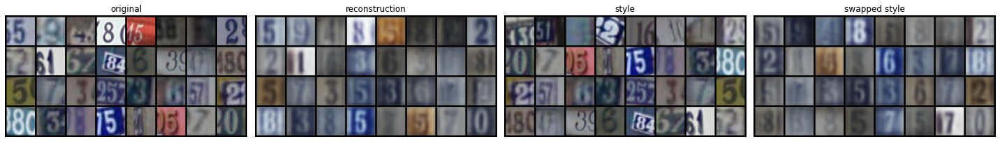

epoch:27 current accuracy:97.32%:  54%|█████████████████████████████████████████████▎                                      | 27/50 [07:28<06:08, 16.04s/it]

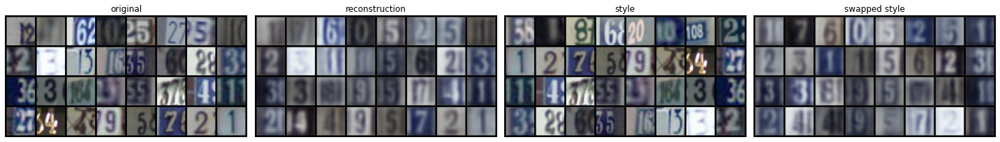

epoch:28 current accuracy:97.38%:  56%|███████████████████████████████████████████████                                     | 28/50 [07:45<05:53, 16.05s/it]

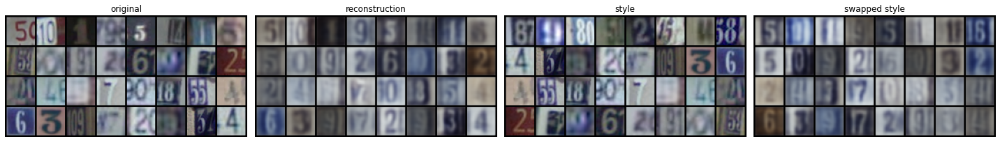

epoch:29 current accuracy:97.36%:  58%|████████████████████████████████████████████████▋                                   | 29/50 [08:01<05:37, 16.08s/it]

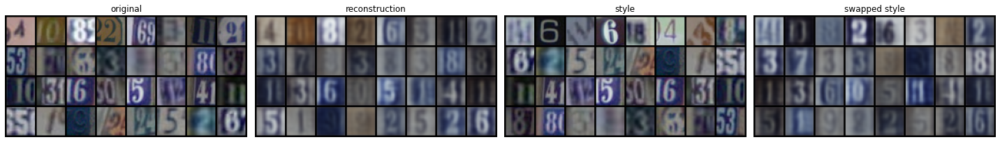

epoch:30 current accuracy:97.45%:  60%|██████████████████████████████████████████████████▍                                 | 30/50 [08:17<05:21, 16.08s/it]

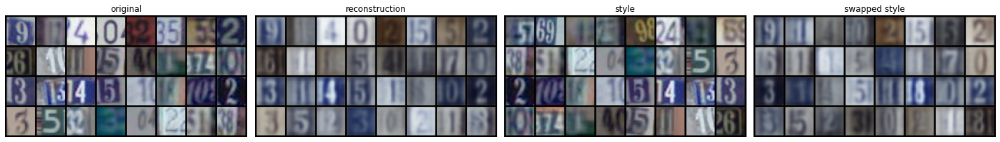

epoch:31 current accuracy:97.56%:  62%|████████████████████████████████████████████████████                                | 31/50 [08:33<05:05, 16.06s/it]

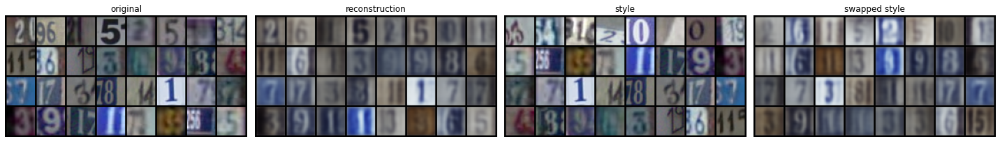

epoch:32 current accuracy:97.65%:  64%|█████████████████████████████████████████████████████▊                              | 32/50 [08:49<04:48, 16.05s/it]

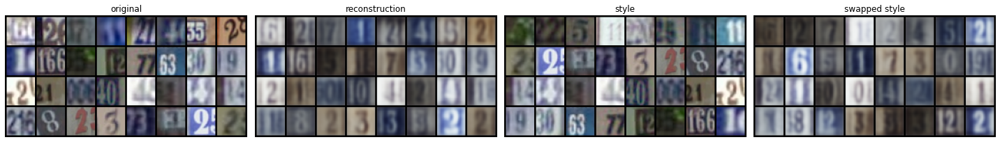

epoch:33 current accuracy:97.55%:  66%|███████████████████████████████████████████████████████▍                            | 33/50 [09:05<04:32, 16.05s/it]

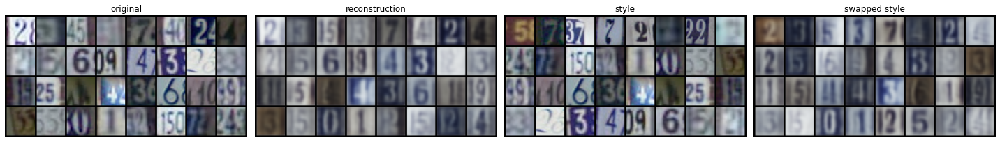

epoch:34 current accuracy:97.74%:  68%|█████████████████████████████████████████████████████████                           | 34/50 [09:21<04:16, 16.06s/it]

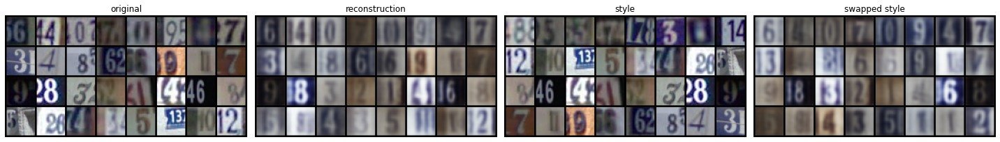

epoch:35 current accuracy:97.75%:  70%|██████████████████████████████████████████████████████████▊                         | 35/50 [09:37<04:00, 16.05s/it]

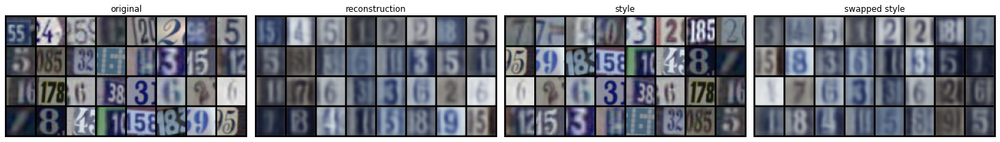

epoch:36 current accuracy:97.69%:  72%|████████████████████████████████████████████████████████████▍                       | 36/50 [09:53<03:44, 16.03s/it]

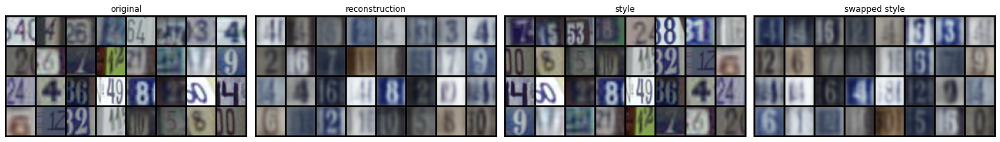

epoch:37 current accuracy:97.74%:  74%|██████████████████████████████████████████████████████████████▏                     | 37/50 [10:09<03:28, 16.04s/it]

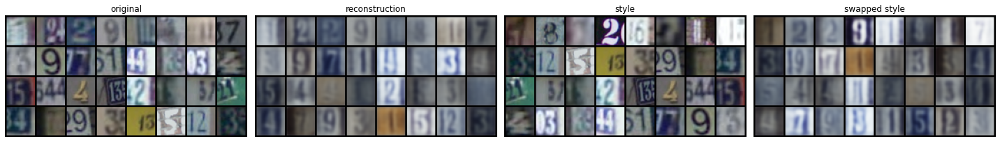

epoch:38 current accuracy:97.73%:  76%|███████████████████████████████████████████████████████████████▊                    | 38/50 [10:25<03:12, 16.03s/it]

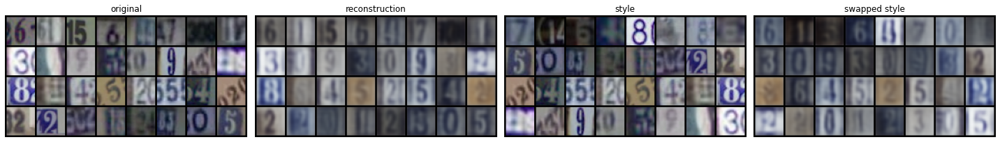

epoch:39 current accuracy:97.9%:  78%|██████████████████████████████████████████████████████████████████▎                  | 39/50 [10:41<02:56, 16.04s/it]

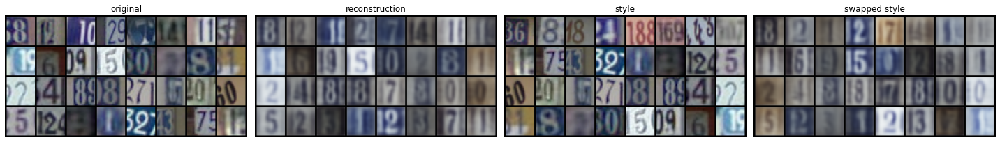

epoch:40 current accuracy:97.99%:  80%|███████████████████████████████████████████████████████████████████▏                | 40/50 [10:57<02:40, 16.08s/it]

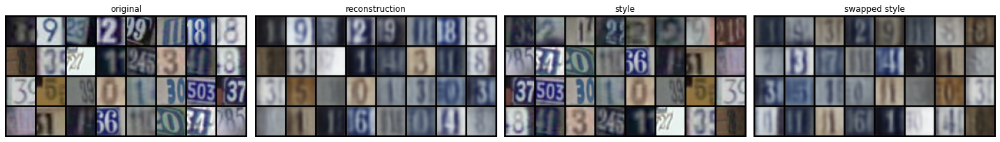

epoch:41 current accuracy:97.98%:  82%|████████████████████████████████████████████████████████████████████▉               | 41/50 [11:13<02:24, 16.06s/it]

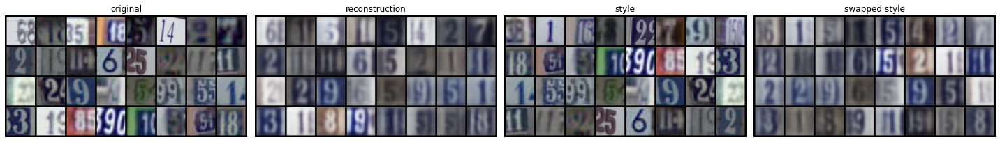

epoch:42 current accuracy:98.11%:  84%|██████████████████████████████████████████████████████████████████████▌             | 42/50 [11:29<02:08, 16.06s/it]

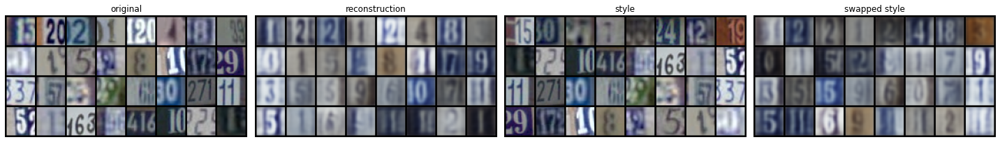

epoch:43 current accuracy:97.93%:  86%|████████████████████████████████████████████████████████████████████████▏           | 43/50 [11:45<01:52, 16.04s/it]

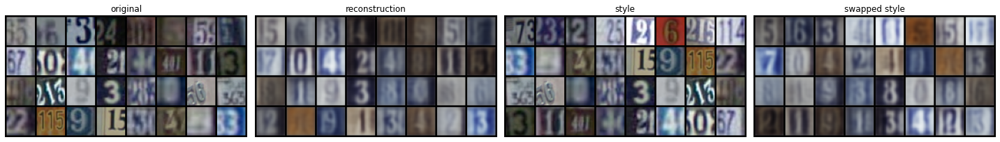

epoch:44 current accuracy:98.11%:  88%|█████████████████████████████████████████████████████████████████████████▉          | 44/50 [12:01<01:36, 16.03s/it]

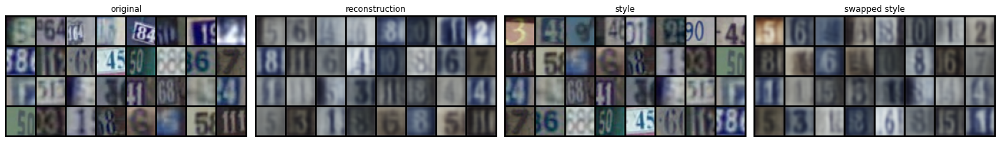

epoch:45 current accuracy:98.09%:  90%|███████████████████████████████████████████████████████████████████████████▌        | 45/50 [12:17<01:20, 16.05s/it]

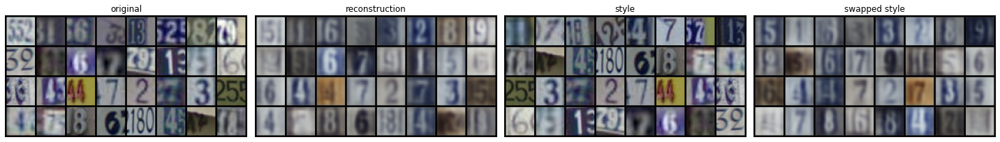

epoch:46 current accuracy:98.09%:  92%|█████████████████████████████████████████████████████████████████████████████▎      | 46/50 [12:33<01:04, 16.05s/it]

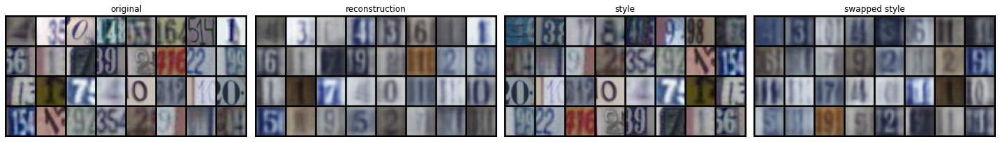

epoch:47 current accuracy:98.07%:  94%|██████████████████████████████████████████████████████████████████████████████▉     | 47/50 [12:49<00:48, 16.04s/it]

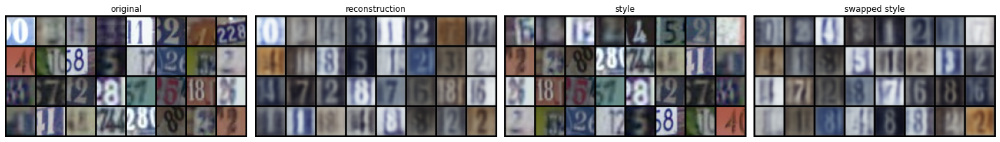

epoch:48 current accuracy:98.09%:  96%|████████████████████████████████████████████████████████████████████████████████▋   | 48/50 [13:05<00:32, 16.03s/it]

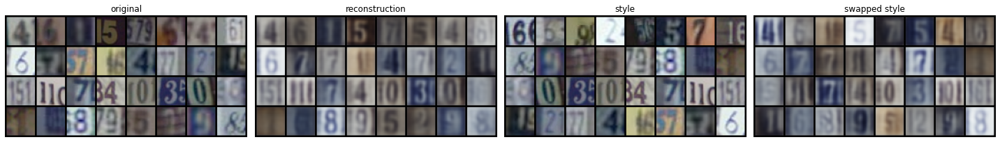

epoch:49 current accuracy:98.1%:  98%|███████████████████████████████████████████████████████████████████████████████████▎ | 49/50 [13:21<00:16, 16.03s/it]

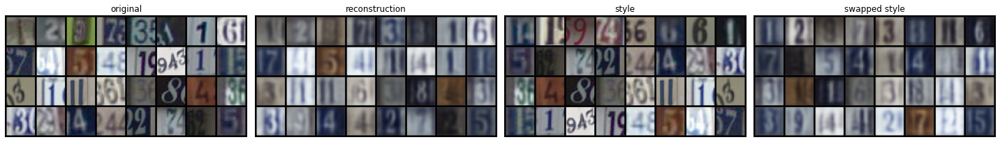

epoch:49 current accuracy:98.1%: 100%|█████████████████████████████████████████████████████████████████████████████████████| 50/50 [13:22<00:00, 16.04s/it]


In [5]:
from train import train_disentangle

train_disentangle(model, 
                  optimizer, 
                  source_train_loader, 
                  epochs=50, 
                  beta_max=10, 
                  running_beta=10, 
                  show_images=True)

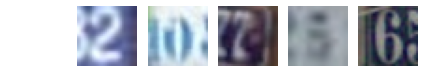

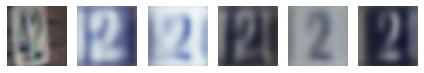

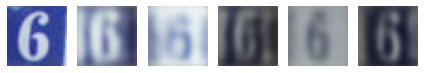

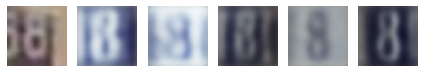

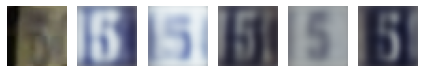

...

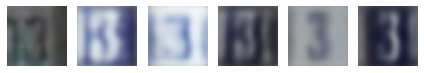

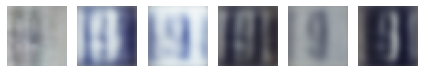

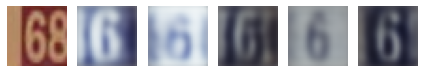

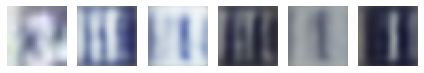

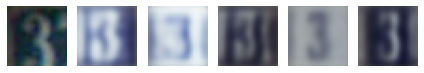

In [6]:
from utils import plot_swapped_styles

plot_swapped_styles(model, source_train_loader)

epoch:0 current accuracy:97.37%:   0%|                                                                                              | 0/30 [00:15<?, ?it/s]

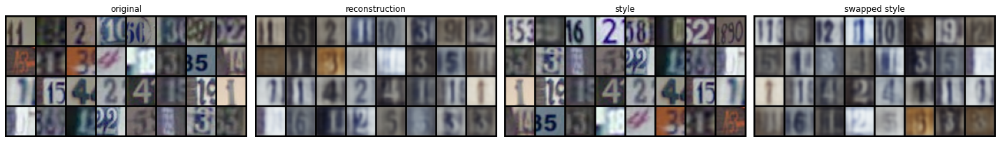

epoch:1 current accuracy:97.81%:   3%|██▊                                                                                   | 1/30 [00:31<07:44, 16.00s/it]

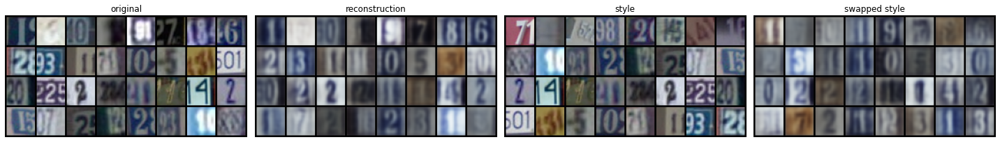

epoch:2 current accuracy:98.13%:   7%|█████▋                                                                                | 2/30 [00:47<07:27, 16.00s/it]

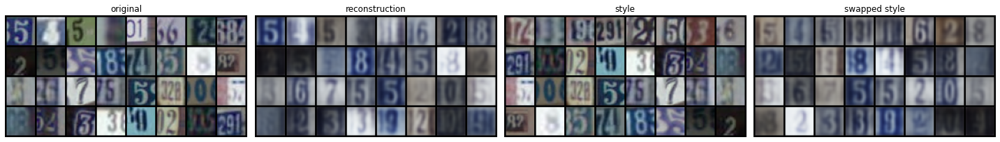

epoch:3 current accuracy:98.13%:  10%|████████▌                                                                             | 3/30 [01:03<07:12, 16.02s/it]

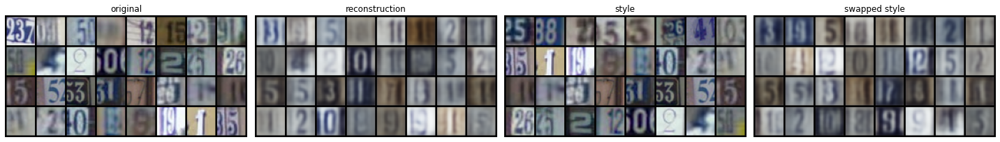

epoch:4 current accuracy:98.12%:  13%|███████████▍                                                                          | 4/30 [01:19<06:56, 16.03s/it]

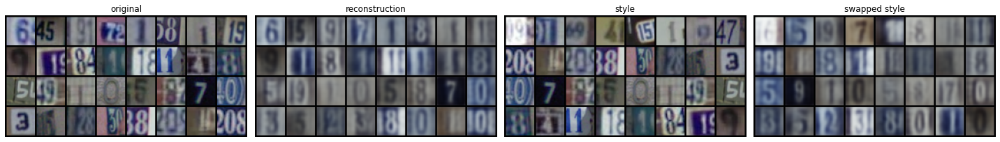

epoch:5 current accuracy:98.22%:  17%|██████████████▎                                                                       | 5/30 [01:35<06:40, 16.02s/it]

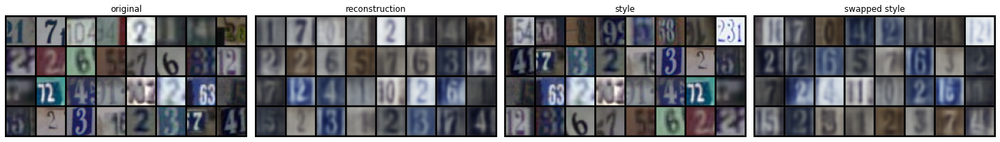

epoch:6 current accuracy:98.22%:  20%|█████████████████▏                                                                    | 6/30 [01:51<06:24, 16.01s/it]

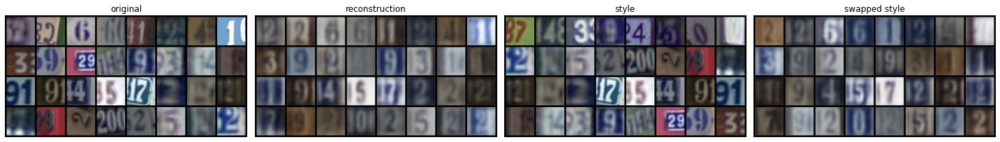

epoch:7 current accuracy:98.34%:  23%|████████████████████                                                                  | 7/30 [02:07<06:09, 16.05s/it]

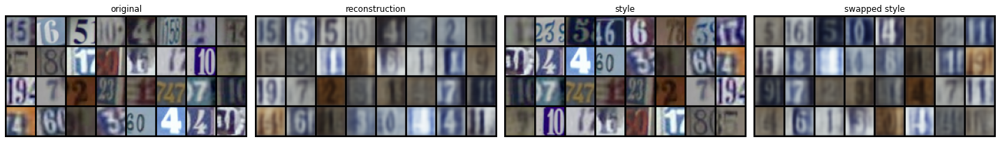

epoch:8 current accuracy:98.17%:  27%|██████████████████████▉                                                               | 8/30 [02:23<05:52, 16.04s/it]

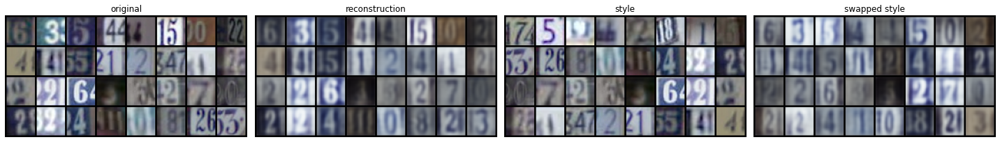

epoch:9 current accuracy:98.19%:  30%|█████████████████████████▊                                                            | 9/30 [02:40<05:36, 16.04s/it]

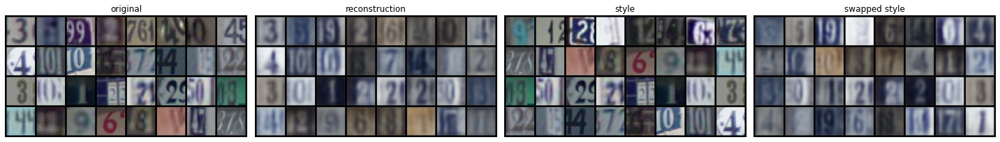

epoch:10 current accuracy:98.26%:  33%|████████████████████████████                                                        | 10/30 [02:56<05:20, 16.04s/it]

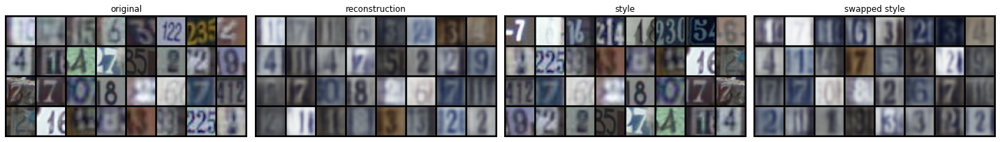

epoch:11 current accuracy:98.22%:  37%|██████████████████████████████▊                                                     | 11/30 [03:12<05:04, 16.05s/it]

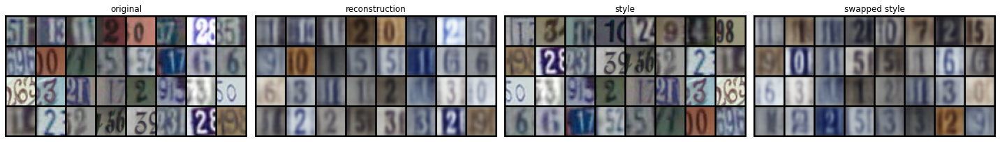

epoch:12 current accuracy:98.26%:  40%|█████████████████████████████████▌                                                  | 12/30 [03:28<04:48, 16.04s/it]

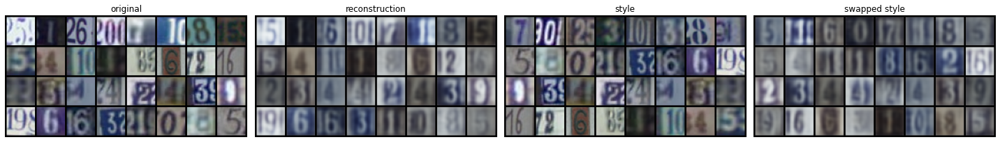

epoch:13 current accuracy:98.38%:  43%|████████████████████████████████████▍                                               | 13/30 [03:44<04:33, 16.10s/it]

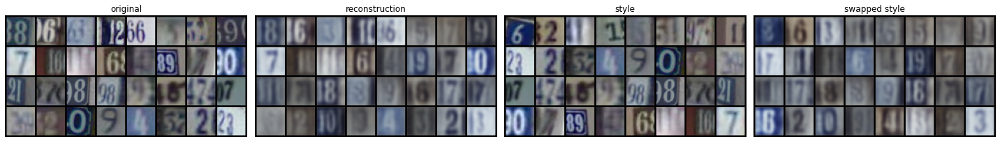

epoch:14 current accuracy:98.21%:  47%|███████████████████████████████████████▏                                            | 14/30 [04:00<04:17, 16.08s/it]

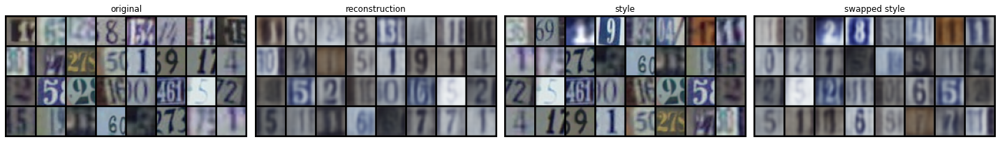

epoch:15 current accuracy:98.27%:  50%|██████████████████████████████████████████                                          | 15/30 [04:16<04:01, 16.07s/it]

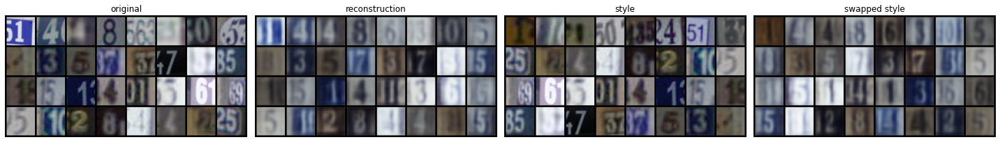

epoch:16 current accuracy:98.33%:  53%|████████████████████████████████████████████▊                                       | 16/30 [04:32<03:44, 16.07s/it]

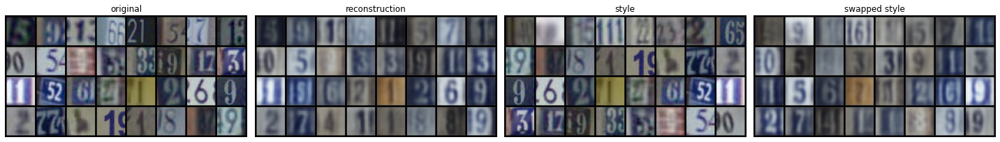

epoch:17 current accuracy:98.36%:  57%|███████████████████████████████████████████████▌                                    | 17/30 [04:48<03:28, 16.05s/it]

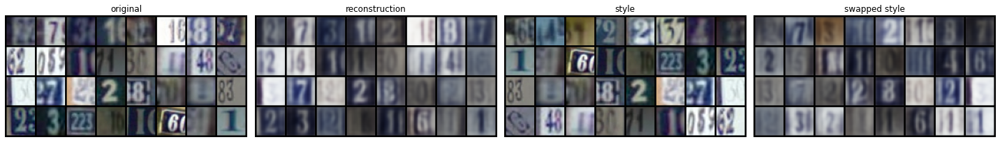

epoch:18 current accuracy:98.22%:  60%|██████████████████████████████████████████████████▍                                 | 18/30 [05:04<03:12, 16.07s/it]

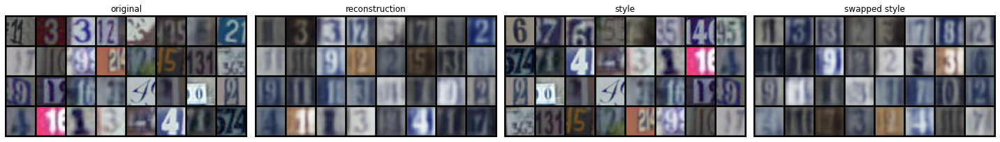

epoch:19 current accuracy:98.39%:  63%|█████████████████████████████████████████████████████▏                              | 19/30 [05:20<02:56, 16.08s/it]

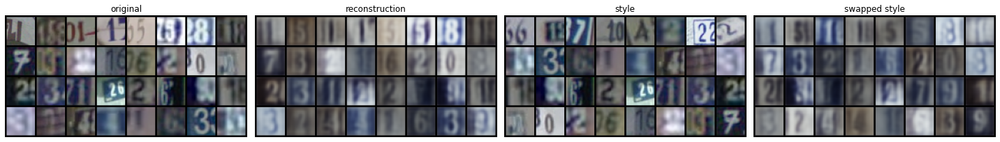

epoch:20 current accuracy:98.41%:  67%|████████████████████████████████████████████████████████                            | 20/30 [05:36<02:40, 16.07s/it]

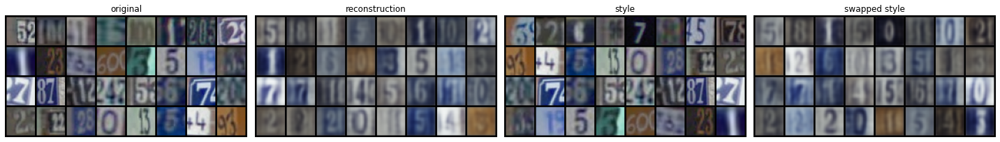

epoch:21 current accuracy:98.32%:  70%|██████████████████████████████████████████████████████████▊                         | 21/30 [05:52<02:24, 16.05s/it]

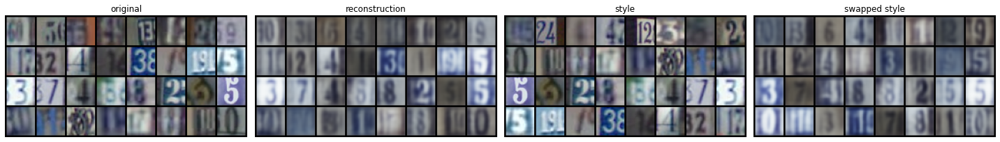

epoch:22 current accuracy:98.41%:  73%|█████████████████████████████████████████████████████████████▌                      | 22/30 [06:08<02:08, 16.05s/it]

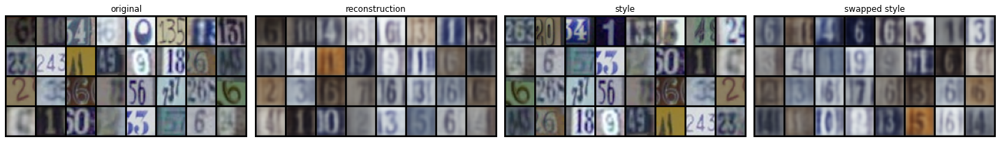

epoch:23 current accuracy:98.37%:  77%|████████████████████████████████████████████████████████████████▍                   | 23/30 [06:24<01:52, 16.04s/it]

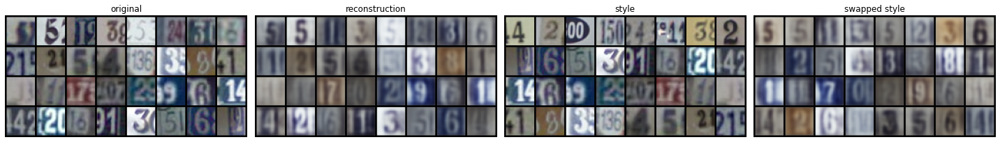

epoch:24 current accuracy:98.29%:  80%|███████████████████████████████████████████████████████████████████▏                | 24/30 [06:41<01:36, 16.09s/it]

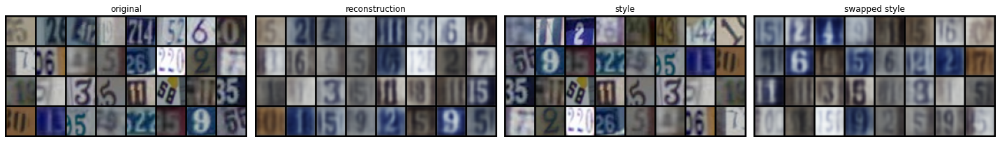

epoch:25 current accuracy:98.37%:  83%|██████████████████████████████████████████████████████████████████████              | 25/30 [06:57<01:20, 16.07s/it]

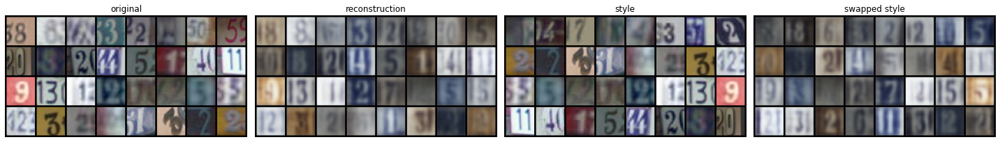

epoch:26 current accuracy:98.36%:  87%|████████████████████████████████████████████████████████████████████████▊           | 26/30 [07:13<01:04, 16.06s/it]

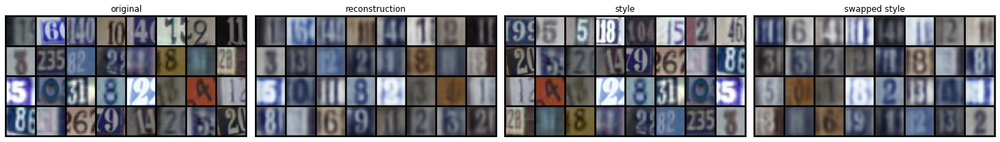

epoch:27 current accuracy:98.38%:  90%|███████████████████████████████████████████████████████████████████████████▌        | 27/30 [07:29<00:48, 16.07s/it]

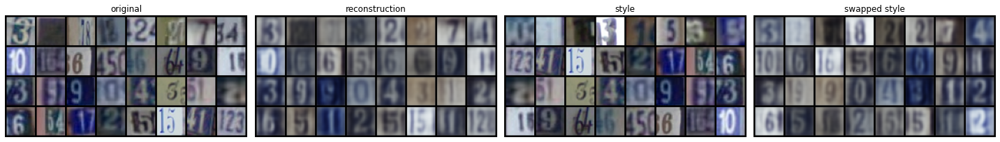

epoch:28 current accuracy:98.32%:  93%|██████████████████████████████████████████████████████████████████████████████▍     | 28/30 [07:45<00:32, 16.06s/it]

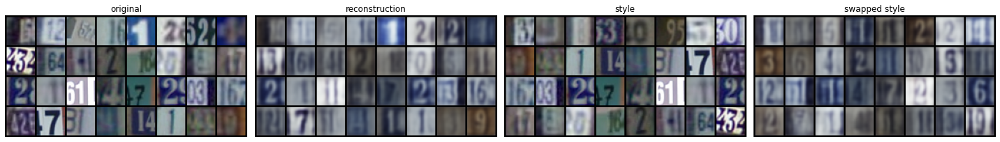

epoch:29 current accuracy:98.41%:  97%|█████████████████████████████████████████████████████████████████████████████████▏  | 29/30 [08:01<00:16, 16.08s/it]

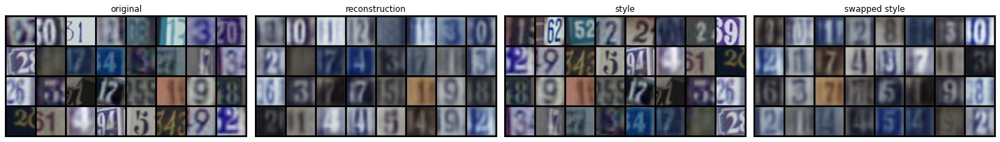

epoch:29 current accuracy:98.41%: 100%|████████████████████████████████████████████████████████████████████████████████████| 30/30 [08:01<00:00, 16.06s/it]


In [7]:
train_disentangle(model, 
                  optimizer, 
                  source_train_loader, 
                  epochs=30, 
                  beta_max=1, 
                  running_beta=10, 
                  show_images=True)

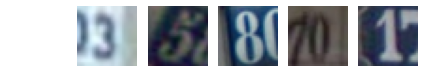

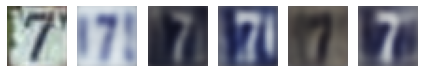

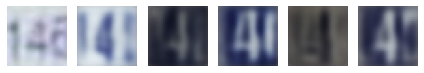

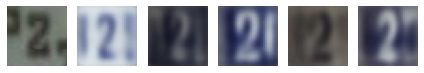

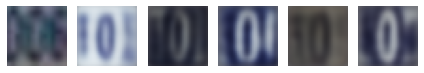

...

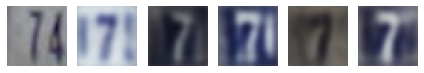

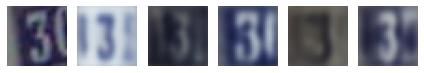

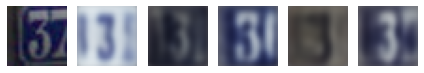

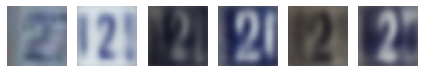

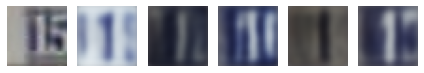

In [10]:
plot_swapped_styles(model, source_train_loader)